# Part I - (Prosper Loan Dataset Exploration)
## by (Emmanuel Chukwuka Oraegbu)

## Introduction
> Introduce the dataset

>**Rubric Tip**: Your code should not generate any errors, and should use functions, loops where possible to reduce repetitive code. Prefer to use functions to reuse code statements.

> **Rubric Tip**: Document your approach and findings in markdown cells. Use comments and docstrings in code cells to document the code functionality.

>**Rubric Tip**: Markup cells should have headers and text that organize your thoughts, findings, and what you plan on investigating next.  

## Importations and settings initialization

> Import all the necessary libraries and set all the appropriate warnings

In [1]:
# import all packages and set plots to be embedded inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import warnings

%matplotlib inline

In [2]:
# Set warnings to ignore filter warnings
warnings.filterwarnings('ignore')

In [3]:
# For better assessment set pandasDataFrame not to collapse rows and columns when displaying them
pd.set_option('display.max_rows', None, 'display.max_columns', None)

In [4]:
# Error:
# SettingWithCopyWarning: A value is trying to be set on a copy of a
# slice from a DataFrame

# As explained in the Source, this warning is usually safe to ignore. You
# can disable it by running the following:
pd.options.mode.chained_assignment = None  # default='warn'

## Connect to the data set

> Load in your dataset and describe its properties through the questions below. Try and motivate your exploration goals through this section.

In [5]:
# load in the dataset into a pandas dataframe and make a copy of the dataFrame
loan_df = pd.read_csv('prosperLoanData.csv')
prosper = loan_df.copy()

## Preliminary Wrangling
>High Level (programmatic) Assessment of the Data Shape and Composition

In [6]:
prosper.head(10)

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,GroupKey,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanKey,TotalProsperLoans,TotalProsperPaymentsBilled,OnTimeProsperPayments,ProsperPaymentsLessThanOneMonthLate,ProsperPaymentsOneMonthPlusLate,ProsperPrincipalBorrowed,ProsperPrincipalOutstanding,ScorexChangeAtTimeOfListing,LoanCurrentDaysDelinquent,LoanFirstDefaultedCycleNumber,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,LoanOriginationDate,LoanOriginationQuarter,MemberKey,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,NaN,NaN,NaN,NaN,NaN,NaN,0,CO,Other,Self-employed,2.0,True,True,NaN,2007-08-26 18:41:46.780000000,640.0,659.0,2001-10-11 00:00:00,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,"$25,000-49,999",True,3083.333333,E33A3400205839220442E84,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,78,19141,9425,2007-09-12 00:00:00,Q3 2007,1F3E3376408759268057EDA,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,A,7.0,2,CO,Professional,Employed,44.0,False,False,NaN,2014-02-27 08:28:14,680.0,699.0,1996-03-18 00:00:00,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,"$50,000-74,999",True,6125.000000,9E3B37071505919926B1D82,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,134815,10000,2014-03-03 00:00:00,Q1 2014,1D13370546739025387B2F4,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,NaN,NaN,NaN,NaN,NaN,NaN,0,GA,Other,Not available,NaN,False,True,783C3371218786870A73D20,2007-01-02 14:09:10.060000000,480.0,499.0,2002-07-27 00:00:00,NaN,NaN,3.0,0,0.0,0.0,1.0,1.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.06,Not displayed,True,2083.333333,6954337960046817851BCB2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,86,6466,3001,2007-01-17 00:00:00,Q1 2007,5F7033715035555618FA612,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,A,9.0,16,GA,Skilled Labor,Employed,113.0,True,False,NaN,2012-10-22 11:02:32,800.0,819.0,1983-02-28 00:00:00,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,"$25,000-49,999",True,2875.000000,A0393664465886295619C51,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,16,77296,10000,2012-11-01 00:00:00,Q4 2012,9ADE356069835475068C6D2,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,0.18316,0.0925,0.09066,3.0,D,4.0,2,MN

In [7]:
prosper.tail(10)

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,GroupKey,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanKey,TotalProsperLoans,TotalProsperPaymentsBilled,OnTimeProsperPayments,ProsperPaymentsLessThanOneMonthLate,ProsperPaymentsOneMonthPlusLate,ProsperPrincipalBorrowed,ProsperPrincipalOutstanding,ScorexChangeAtTimeOfListing,LoanCurrentDaysDelinquent,LoanFirstDefaultedCycleNumber,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,LoanOriginationDate,LoanOriginationQuarter,MemberKey,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
113927,E3433419834735803891976,322787,2008-04-30 21:25:19.670000000,AA,36,Completed,2011-05-09 00:00:00,0.07469,0.0679,0.0579,NaN,NaN,NaN,NaN,NaN,NaN,4,WA,Executive,Full-time,69.0,True,True,D1413413671123312FAD936,2008-04-30 21:20:54.587000000,760.0,779.0,1972-09-09 00:00:00,10.0,8.0,18.0,7,763.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,89961.0,0.72,34415.0,17.0,1.00,1.0,0.06,"$100,000+",True,10333.333333,895E341956005398355C384,1.0,6.0,6.0,0.0,0.0,1000.0,847.61,0.0,0,NaN,70,30797,4292,2008-05-09 00:00:00,Q2 2008,5BAF33803622558831EA3AC,132.11,4756.9200,4291.99,464.9300,-68.47,0.0,0.0,0.0,0.0,1.0,2,0,0.0,194
113928,E34935176664905343E01EA,510097,2011-06-06 19:02:44.443000000,NaN,36,Completed,2011-09-19 00:00:00,0.22362,0.1899,0.1799,0.17570,0.0610,0.11470,4.0,C,6.0,3,CO,Other,Full-time,22.0,False,False,NaN,2011-06-03 16:06:00,740.0,759.0,2004-06-06 00:00:00,4.0,3.0,15.0,2,7.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,4.0,0.00,3746.0,15.0,1.00,0.0,0.27,"$25,000-49,999",True,2333.333333,73D936216341471895FF2FC,5.0,47.0,47.0,0.0,0.0,14250.0,0.02,8.0,0,NaN,33,50237,2000,2011-06-10 00:00:00,Q2 2011,3A2F3380477699707C81385,73.30,2083.6200,2000.00,83.6200,-4.41,0.0,0.0,0.0,0.0,1.0,0,0,0.0,25
113929,E3553583161337791FCB87F,830413,2013-07-06 17:40:01.657000000,NaN,36,Completed,2014-02-07 00:00:00,0.30285,0.2639,0.2539,0.23180,0.1225,0.10930,2.0,E,3.0,2,FL,Accountant/CPA,Employed,25.0,False,False,NaN,2013-07-06 17:39:52,660.0,679.0,2008-11-17 00:00:00,7.0,7.0,14.0,7,135.0,2.0,19.0,0.0,0.0,9.0,0.0,0.0,1109.0,0.11,7537.0,11.0,0.75,1.0,0.05,"$50,000-74,999",True,4333.333333,F8973687907243662215A6F,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,8,95171,2500,2013-07-10 00:00:00,Q3 2013,CBD43555702871369F462DA,101.25,2672.5800,2500.00,172.5800,-6.54,0.0,0.0,0.0,0.0,1.0,0,0,0.0,26
113930,E35D3584034795373BCD69A,831523,2013-07-08 10:24:49.700000000,NaN,36,Current,NaN,0.20053,0.1639,0.1539,0.14520,0.0574,0.08780,5.0,B,6.0,1,IN,Professional,Employed,85.0,True,False,NaN,2013-07-08 10:24:38,680.0,699.0,1999-12-20 00:00:00,16.0,10.0,31.0,6,169.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,3245.0,0.60,1322.0,30.0,0.96,0.0,0.20,"$75,000-99,999",True,6250.000000,AF80368651203735984C668,1.0,7.0,7.0,0.0,0.0,2000.0,889.75,-73.0,0,NaN,8,95132,3000,2013-07-10 00:00:00,Q3 2013,89A735620041442181964DB,106.05,742.3500,471.89,270.4600,-16.51,0.0,0.0,0.0,0.0,1.0,0,0,0.0,52
113931,E36F36005339663245C20F8,1141292,2014-01-16 20:13:08.040000000

In [8]:
prosper.shape

(113937, 81)

In [9]:
prosper.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113937 entries, 0 to 113936
Data columns (total 81 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   ListingKey                           113937 non-null  object 
 1   ListingNumber                        113937 non-null  int64  
 2   ListingCreationDate                  113937 non-null  object 
 3   CreditGrade                          28953 non-null   object 
 4   Term                                 113937 non-null  int64  
 5   LoanStatus                           113937 non-null  object 
 6   ClosedDate                           55089 non-null   object 
 7   BorrowerAPR                          113912 non-null  float64
 8   BorrowerRate                         113937 non-null  float64
 9   LenderYield                          113937 non-null  float64
 10  EstimatedEffectiveYield              84853 non-null   float64
 11  EstimatedLoss

In [10]:
prosper.describe()

,ListingNumber,Term,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperScore,ListingCategory (numeric),EmploymentStatusDuration,CreditScoreRangeLower,CreditScoreRangeUpper,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,StatedMonthlyIncome,TotalProsperLoans,TotalProsperPaymentsBilled,OnTimeProsperPayments,ProsperPaymentsLessThanOneMonthLate,ProsperPaymentsOneMonthPlusLate,ProsperPrincipalBorrowed,ProsperPrincipalOutstanding,ScorexChangeAtTimeOfListing,LoanCurrentDaysDelinquent,LoanFirstDefaultedCycleNumber,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
count,1.139370e+05,113937.000000,113912.000000,113937.000000,113937.000000,84853.000000,84853.000000,84853.000000,84853.000000,84853.000000,113937.000000,106312.000000,113346.000000,113346.000000,106333.000000,106333.000000,113240.000000,113937.00000,113937.000000,113240.000000,112778.000000,113240.000000,106315.000000,112947.000000,113240.000000,106333.000000,1.063330e+05,106333.000000,106393.000000,106393.000000,106393.000000,106393.000000,105383.000000,1.139370e+05,22085.000000,22085.000000,22085.000000,22085.000000,22085.000000,22085.000000,22085.000000,18928.000000,113937.000000,16952.000000,113937.000000,113937.000000,113937.00000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000
mean,6.278857e+05,40.830248,0.218828,0.192764,0.182701,0.168661,0.080306,0.096068,4.072243,5.950067,2.774209,96.071582,685.567731,704.567731,10.317192,9.260164,26.754539,6.96979,398.292161,1.435085,5.584405,0.592052,984.507059,4.154984,0.312646,0.015094,1.759871e+04,0.561309,11210.225447,23.230034,0.885897,0.802327,0.275947,5.608026e+03,1.421100,22.934345,22.271949,0.613629,0.048540,8472.311961,2930.313906,-3.223214,152.816539,16.268464,31.896882,69444.474271,8337.01385,272.475783,4183.079489,3105.536588,1077.542901,-54.725641,-14.242698,700.446342,681.420499,25.142686,0.998584,0.048027,0.023460,16.550751,80.475228
std,3.280762e+05,10.436212,0.080364,0.074818,0.074516,0.068467,0.046764,0.030403,1.673227,2.376501,3.996797,94.480605,66.458275,66.458275,5.457866,5.022644,13.637871,4.63097,447.159711,2.437507,6.429946,1.978707,7158.270157,10.160216,0.727868,0.154092,3.293640e+04,0.317918,19818.361309,11.871311,0.148179,1.097637,0.551759,7.478497e+03,0.764042,19.249584,18.830425,2.446827,0.556285,7395.507650,3806.635075,50.063567,466.320254,9.005898,29.974184,38930.479610,6245.80058,192.697812,4790.907234,4069.527670,1183.414168,60.675425,109.232758,2388.513831,2357.167068,275.657937,0.017919,0.332353,0.232412,294.545422,103.239020
min,4.000000e+00,12.000000,0.006530,0.000000,-0.010000,-0.182700,0.004900,-0.182700,1.000000,1.000000,0.000000,0.000000,0.000000,19.000000,0.000000,0.000000,2.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-209.000000,0.000000,0.000000,0.000000,1.000000,1000.00000,0.000000,-2.349900,0.000000,-2.349900,-664.870000,-9274.750000,-94.200000,-954.550000,0.000000,0.700000,0.000000,0.000000,0.000000,1.000000
25%,4.009190e+05,36.000000

In [11]:
prosper.duplicated().sum()

0

### What is the structure of your dataset?

> This data set contains 113,937 loans with 81 variables on each loan, including loan amount, borrower rate (or interest rate), current loan status, borrower income, and many others. 42 columns contain some null or missing values. The details of the variables of interest are given below

>* ListingKey	Unique key for each listing, same value as the 'key' used in the listing object in the API.
>* ListingNumber	The number that uniquely identifies the listing to the public as displayed on the website.
-ListingCreationDate	The date the listing was created.
-CreditGrade	The Credit rating that was assigned at the time the listing went live. Applicable for listings pre-2009 period and will only be populated for those listings.
-Term	The length of the loan expressed in months.
-LoanStatus	The current status of the loan: Cancelled,  Chargedoff, Completed, Current, Defaulted, FinalPaymentInProgress, ---- -PastDue. The PastDue status will be accompanied by a delinquency bucket.
-ClosedDate	Closed date is applicable for Cancelled, Completed, Chargedoff and Defaulted loan statuses. 
-BorrowerAPR	The Borrower's Annual Percentage Rate (APR) for the loan.
-BorrowerRate	The Borrower's interest rate for this loan. 
-LenderYield	The Lender yield on the loan. Lender yield is equal to the interest rate on the loan less the servicing fee.
-EstimatedEffectiveYield	Effective yield is equal to the borrower interest rate (i) minus the servicing fee rate, (ii) minus estimated uncollected interest on charge-offs, (iii) plus estimated collected late fees.  Applicable for loans originated after July 2009.
-EstimatedLoss	Estimated loss is the estimated principal loss on charge-offs. Applicable for loans originated after July 2009.
-EstimatedReturn	The estimated return assigned to the listing at the time it was created. Estimated return is the difference between the Estimated Effective Yield and the Estimated Loss Rate. Applicable for loans originated after July 2009.
-ProsperRating (numeric)	The  Prosper Rating assigned at the time the listing was created: 0 - N/A, 1 - HR, 2 - E, 3 - D, 4  C, 5 - B, 6 - A, 7 - AA.  Applicable for loans originated after July 2009.
-ProsperRating (Alpha)	The Prosper Rating assigned at the time the listing was created between AA - HR.  Applicable for loans originated after July 2009.
-ProsperScore	A custom risk score built using historical Prosper data. The score ranges from 1-10, with 10 being the best, or lowest risk score.  Applicable for loans originated after July 2009.
-ListingCategory	The category of the listing that the borrower selected when posting their listing: 0 - Not Available, 1 - --Debt Consolidation, 2 - Home Improvement, 3 - Business, 4 - Personal Loan, 5 - Student Use, 6 - Auto, 7- Other, 8 - Baby&Adoption, 9 - Boat, 10 - Cosmetic Procedure, 11 - Engagement Ring, 12 - Green Loans, 13 - Household Expenses, 14 - Large Purchases, 15 - Medical/Dental, 16 - Motorcycle, 17 - RV, 18 - Taxes, 19 - Vacation, 20 - Wedding Loans
-BorrowerState	The two letter abbreviation of the state of the address of the borrower at the time the Listing was created.
-Occupation	The Occupation selected by the Borrower at the time they created the listing.
-EmploymentStatus	The employment status of the borrower at the time they posted the listing.
-EmploymentStatusDuration	The length in months of the employment status at the time the listing was created.
-IsBorrowerHomeowner	A Borrower will be classified as a homowner if they have a mortgage on their credit profile or provide documentation confirming they are a homeowner.
-CurrentlyInGroup	Specifies whether or not the Borrower was in a group at the time the listing was created.
-GroupKey	The Key of the group in which the Borrower is a member of. Value will be null if the borrower does not have a group affiliation.
-DateCreditPulled	The date the credit profile was pulled. 
-CreditScoreRangeLower	The lower value representing the range of the borrower's credit score as provided by a consumer credit rating agency.
-CreditScoreRangeUpper	The upper value representing the range of the borrower's credit score as provided by a consumer credit rating agency. 
-FirstRecordedCreditLine	The date the first credit line was opened.
-CurrentCreditLines	Number of current credit lines at the time the credit profile was pulled.
-OpenCreditLines	Number of open credit lines at the time the credit profile was pulled.
-TotalCreditLinespast7years	Number of credit lines in the past seven years at the time the credit profile was pulled.
-OpenRevolvingAccounts	Number of open revolving accounts at the time the credit profile was pulled.
-OpenRevolvingMonthlyPayment	Monthly payment on revolving accounts at the time the credit profile was pulled.
-InquiriesLast6Months	Number of inquiries in the past six months at the time the credit profile was pulled.
-TotalInquiries	Total number of inquiries at the time the credit profile was pulled.
-CurrentDelinquencies	Number of accounts delinquent at the time the credit profile was pulled.
-AmountDelinquent	Dollars delinquent at the time the credit profile was pulled.
-DelinquenciesLast7Years	Number of delinquencies in the past 7 years at the time the credit profile was pulled.
-PublicRecordsLast10Years	Number of public records in the past 10 years at the time the credit profile was pulled.
-PublicRecordsLast12Months	Number of public records in the past 12 months at the time the credit profile was pulled.
-RevolvingCreditBalance	Dollars of revolving credit at the time the credit profile was pulled.
-BankcardUtilization	The percentage of available revolving credit that is utilized at the time the credit profile was pulled.
-AvailableBankcardCredit	The total available credit via bank card at the time the credit profile was pulled.
-TotalTrades	Number of trade lines ever opened at the time the credit profile was pulled.
-TradesNeverDelinquent	Number of trades that have never been delinquent at the time the credit profile was pulled.
-TradesOpenedLast6Months	Number of trades opened in the last 6 months at the time the credit profile was pulled.
-DebtToIncomeRatio	The debt to income ratio of the borrower at the time the credit profile was pulled. This value is Null if the debt to income ratio is not available. This value is capped at 10.01 (any debt to income ratio larger than 1000% will be returned as 1001%).
-IncomeRange	The income range of the borrower at the time the listing was created.
-IncomeVerifiable	The borrower indicated they have the required documentation to support their income.
-StatedMonthlyIncome	The monthly income the borrower stated at the time the listing was created.
-LoanKey	Unique key for each loan. This is the same key that is used in the API. 
-TotalProsperLoans	Number of Prosper loans the borrower at the time they created this listing. This value will be null if the borrower had no prior loans. 
-TotalProsperPaymentsBilled	Number of on time payments the borrower made on Prosper loans at the time they created this listing. This value will be null if the borrower had no prior loans.
-OnTimeProsperPayments	Number of on time payments the borrower had made on Prosper loans at the time they created this listing. This value will be null if the borrower has no prior loans.
-ProsperPaymentsLessThanOneMonthLate	Number of payments the borrower made on Prosper loans that were less than one month late at the time they created this listing. This value will be null if the borrower had no prior loans. 
-ProsperPaymentsOneMonthPlusLate	Number of payments the borrower made on Prosper loans that were greater than one month late at the time they created this listing. This value will be null if the borrower had no prior loans.
-ProsperPrincipalBorrowed	Total principal borrowed on Prosper loans at the time the listing was created. This value will be null if the borrower had no prior loans.
-ProsperPrincipalOutstanding	Principal outstanding on Prosper loans at the time the listing was created. This value will be null if the borrower had no prior loans.
-ScorexChangeAtTimeOfListing	Borrower's credit score change at the time the credit profile was pulled. This will be the change relative to the borrower's last Prosper loan. This value will be null if the borrower had no prior loans.
-LoanCurrentDaysDelinquent	The number of days delinquent. 
-LoanFirstDefaultedCycleNumber	The cycle the loan was charged off. If the loan has not charged off the value will be null. 
-LoanMonthsSinceOrigination	Number of months since the loan originated.
-LoanNumber	Unique numeric value associated with the loan.
-LoanOriginalAmount	The origination amount of the loan.
-LoanOriginationDate	The date the loan was originated.
-LoanOriginationQuarter	The quarter in which the loan was originated.
-MemberKey	The unique key that is associated with the borrower. This is the same identifier that is used in the API member object. 
-MonthlyLoanPayment	The scheduled monthly loan payment.
-LP_CustomerPayments	Pre charge-off cumulative gross payments made by the borrower on the loan. If the loan has charged off, this value will exclude any recoveries.
-LP_CustomerPrincipalPayments	Pre charge-off cumulative principal payments made by the borrower on the loan. If the loan has charged off, this value will exclude any recoveries.
-LP_InterestandFees	Pre charge-off cumulative interest and fees paid by the borrower. If the loan has charged off, this value will exclude any recoveries.
-LP_ServiceFees	Cumulative service fees paid by the investors who have invested in the loan. 
-LP_CollectionFees	Cumulative collection fees paid by the investors who have invested in the loan.
-LP_GrossPrincipalLoss	The gross charged off amount of the loan.
-LP_NetPrincipalLoss	The principal that remains uncollected after any recoveries.
-LP_NonPrincipalRecoverypayments	The interest and fee component of any recovery payments. The current payment policy applies payments in the following order: Fees, interest, principal.
-PercentFunded	Percent the listing was funded.
-Recommendations	Number of recommendations the borrower had at the time the listing was created.
-InvestmentFromFriendsCount	Number of friends that made an investment in the loan.
-InvestmentFromFriendsAmount	Dollar amount of investments that were made by friends.
-Investors	The number of investors that funded the loan.


### What is/are the main feature(s) of interest in your dataset?

> My Hope is to explore this dataset as deeply as possible. However, the primary investigation objective is to determine which states give prosper loans the best of its clients. this can be determined in terms of loans taken and timely repayments made.  other features such as those gainfully employed with verification as well as those that fall within a high income range can help provide more insight. 

### What features in the dataset do you think will help support your investigation into your feature(s) of interest?

> The following features would aid investigations of this data set: loanstatus, term, creditgrade, prosperrating, prosperscore, borrowerstate, occupation, employmentstatus, employmentstatusduration, isborrowerhomeowner amongst others

## A little bit more cleaning

In [12]:
# Change column names to lower case.
prosper.rename(columns = str.lower, inplace = True)

In [13]:
#THE FOLLOWING COLUMNS SHOULD BE CONVERTED TO DATA TYPE INT 
#current credit lines 
#open credit lines 
#inquiries last 6 months 
#total inquiries 
#current deliquencies
#deliquencies last 7 years
#listingcreationdate datatype should be datetime
#closeddate datatype should be datetime
#datecreditpulled datatype should be datetime
#firstrecordedcreditline datatype should be datetime
#loanoriginationdate 
# Credit rating system should form one column

In [14]:
#credit grade has 84984 missing values. This column is represents a variable of ordinal data type and is a record of the credit
#worthiness of the customer. The various levels range from AA which is the highest order through  A,B,C,D,E,HR,AND NC which is 
#the lowest level. 
#We are going to add another level NA which represents not available and use this to fill up the empty rows.
#prosper.creditgrade.fillna('NA', inplace = True)

#### LISTING KEY
>  ListingKey is the Unique key for each listing, same value as the 'key' used in the listing object in the API.
> - Is data type 'object' which is the correct datatype for the variable.
> - Listingkey has 871 duplicated entries. These keys are meant to be unique for each loan entries which means that there should only be one key per loan and one loan entry in the dataset. Having duplicates therefore means that some sort of error occurred during the entering of the loan details. 
> - A comparison of the different duplicates shows that every entry is the same except the prosper score.
> - We are going to assume that the last entry for each key is the correct one and use it. 

In [64]:
prosper['listingkey'].dtypes

dtype('O')

In [60]:
# Check listingkey for duplicates
prosper[prosper['listingkey'].duplicated()]

,listingkey,listingnumber,listingcreationdate,creditgrade,term,loanstatus,closeddate,borrowerapr,borrowerrate,lenderyield,estimatedeffectiveyield,estimatedloss,estimatedreturn,prosperrating (numeric),prosperrating (alpha),prosperscore,listingcategory (numeric),borrowerstate,occupation,employmentstatus,employmentstatusduration,isborrowerhomeowner,currentlyingroup,groupkey,datecreditpulled,creditscorerangelower,creditscorerangeupper,firstrecordedcreditline,currentcreditlines,opencreditlines,totalcreditlinespast7years,openrevolvingaccounts,openrevolvingmonthlypayment,inquirieslast6months,totalinquiries,currentdelinquencies,amountdelinquent,delinquencieslast7years,publicrecordslast10years,publicrecordslast12months,revolvingcreditbalance,bankcardutilization,availablebankcardcredit,totaltrades,tradesneverdelinquent (percentage),tradesopenedlast6months,debttoincomeratio,incomerange,incomeverifiable,statedmonthlyincome,loankey,totalprosperloans,totalprosperpaymentsbilled,ontimeprosperpayments,prosperpaymentslessthanonemonthlate,prosperpaymentsonemonthpluslate,prosperprincipalborrowed,prosperprincipaloutstanding,scorexchangeattimeoflisting,loancurrentdaysdelinquent,loanfirstdefaultedcyclenumber,loanmonthssinceorigination,loannumber,loanoriginalamount,loanoriginationdate,loanoriginationquarter,memberkey,monthlyloanpayment,lp_customerpayments,lp_customerprincipalpayments,lp_interestandfees,lp_servicefees,lp_collectionfees,lp_grossprincipalloss,lp_netprincipalloss,lp_nonprincipalrecoverypayments,percentfunded,recommendations,investmentfromfriendscount,investmentfromfriendsamount,investors,credit_rating
9,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.07620,0.0629,0.0529,0.05221,0.0099,0.04231,7.0,AA,11.0,7,IL,Food Service,Employed,269.0,True,False,NaN,2013-12-02 10:43:39,820.0,839.0,1993-04-01 00:00:00,17.0,16.0,32.0,12,219.0,1.0,6.0,0.0,0.0,0.0,0.0,0.0,9906.0,0.11,77696.0,29.0,1.00,1.0,0.25,"$25,000-49,999",True,3333.333333,02163700809231365A56A1C,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,3,121268,10000,2013-12-12 00:00:00,Q4 2013,49A53699682291323D04D66,305.54,611.0800,505.58,105.5000,-16.77,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,AA
999,0A0635972629771021E38F3,1055932,2013-12-18 14:25:17.053000000,NaN,60,Current,NaN,0.17710,0.1535,0.1435,0.13507,0.0599,0.07517,5.0,B,7.0,1,MD,Other,Employed,100.0,True,False,NaN,2014-02-08 11:39:13,760.0,779.0,1994-11-01 00:00:00,16.0,16.0,34.0,15,623.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,8028.0,0.27,14190.0,32.0,0.96,1.0,0.35,"$25,000-49,999",True,3750.000000,CB643706582969191E8C26B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,1,132043,10000,2014-02-12 00:00:00,Q1 2014,98A937006186534818378B9,239.74,0.0000,0.00,0.0000,0.00,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,B
2539,2D2635984503681189056B4,1097584,2014-01-11 07:50:08.037000000,NaN,60,Current,NaN,0.14528,0.1224,0.1124,0.10731,0.0424,0.06491,5.0,B,10.0,1,NJ,Police Officer/Correction Officer,Employed,107.0,True,False,NaN,2014-03-07 10:04:00,720.0,739.0,1996-07-01 00:00:00,19.0,18.0,27.0,15,1024.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,20802.0,0.40,26503.0,26.0,1.00,1.0,0.18,"$100,000+",True,10833.333333,DC303708663304668E74587,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,135375,35000,2014-03-11 00:00:00,Q1 2014,07B33702526608187DB957A,782.81,0.0000,0.00,0.0000,0.00,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,B
4942,4B7E3590031274113F1FD34,927246,2013-09-26 09:35:36.317000000,NaN,36,Current,NaN,0.35356,0.3134,0.3034,0.27598,0.1625,0.11348,1.0,HR,2.0,7,MI,Laborer,Employed,336.0,True,False,NaN,2013-09-26 09:35:36,640.0,659.0,1978-09-01 00:00:00,7.0,6.0,39.0,6,129.0,3.0,9.0,0.0,0.0,56.0,1.0,0.0,943.0,0.51,798.0,31.0,0.56,2.0,0.07,"$50,000-74,999",True,4583.333333,8D84369399064302947D8B5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,5,103928,4000,2013-10-01 00:00:00,Q4 2013,5E653693258374071BBC02C,172.76,863.8000,362.81,500.9900,-15.98,0.00,0.0,0.0,0.0,1.0,0,0,0.0,40,HR
5812,94B035909835592957503E6,920397,2013-09-24 13:27:48.287000000,NaN,36,Current,NaN,0.24205,0.2045,0.1945,0.17970,0.0899,0.089

In [61]:
# How many listing keys are duplicates
prosper[prosper['listingkey'].duplicated()].shape[0]

871

In [63]:
prosper[prosper['listingkey'] == '0F043596202561788EA13D5']

,listingkey,listingnumber,listingcreationdate,creditgrade,term,loanstatus,closeddate,borrowerapr,borrowerrate,lenderyield,estimatedeffectiveyield,estimatedloss,estimatedreturn,prosperrating (numeric),prosperrating (alpha),prosperscore,listingcategory (numeric),borrowerstate,occupation,employmentstatus,employmentstatusduration,isborrowerhomeowner,currentlyingroup,groupkey,datecreditpulled,creditscorerangelower,creditscorerangeupper,firstrecordedcreditline,currentcreditlines,opencreditlines,totalcreditlinespast7years,openrevolvingaccounts,openrevolvingmonthlypayment,inquirieslast6months,totalinquiries,currentdelinquencies,amountdelinquent,delinquencieslast7years,publicrecordslast10years,publicrecordslast12months,revolvingcreditbalance,bankcardutilization,availablebankcardcredit,totaltrades,tradesneverdelinquent (percentage),tradesopenedlast6months,debttoincomeratio,incomerange,incomeverifiable,statedmonthlyincome,loankey,totalprosperloans,totalprosperpaymentsbilled,ontimeprosperpayments,prosperpaymentslessthanonemonthlate,prosperpaymentsonemonthpluslate,prosperprincipalborrowed,prosperprincipaloutstanding,scorexchangeattimeoflisting,loancurrentdaysdelinquent,loanfirstdefaultedcyclenumber,loanmonthssinceorigination,loannumber,loanoriginalamount,loanoriginationdate,loanoriginationquarter,memberkey,monthlyloanpayment,lp_customerpayments,lp_customerprincipalpayments,lp_interestandfees,lp_servicefees,lp_collectionfees,lp_grossprincipalloss,lp_netprincipalloss,lp_nonprincipalrecoverypayments,percentfunded,recommendations,investmentfromfriendscount,investmentfromfriendsamount,investors,credit_rating
8,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.0762,0.0629,0.0529,0.05221,0.0099,0.04231,7.0,AA,9.0,7,IL,Food Service,Employed,269.0,True,False,NaN,2013-12-02 10:43:39,820.0,839.0,1993-04-01 00:00:00,17.0,16.0,32.0,12,219.0,1.0,6.0,0.0,0.0,0.0,0.0,0.0,9906.0,0.11,77696.0,29.0,1.0,1.0,0.25,"$25,000-49,999",True,3333.333333,02163700809231365A56A1C,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,3,121268,10000,2013-12-12 00:00:00,Q4 2013,49A53699682291323D04D66,305.54,611.08,505.58,105.5,-16.77,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1,AA
9,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.0762,0.0629,0.0529,0.05221,0.0099,0.04231,7.0,AA,11.0,7,IL,Food Service,Employed,269.0,True,False,NaN,2013-12-02 10:43:39,820.0,839.0,1993-04-01 00:00:00,17.0,16.0,32.0,12,219.0,1.0,6.0,0.0,0.0,0.0,0.0,0.0,9906.0,0.11,77696.0,29.0,1.0,1.0,0.25,"$25,000-49,999",True,3333.333333,02163700809231365A56A1C,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,3,121268,10000,2013-12-12 00:00:00,Q4 2013,49A53699682291323D04D66,305.54,611.08,505.58,105.5,-16.77,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1,AA


#### LISTING NUMBER
>* ListingNumber	The number that uniquely identifies the listing to the public as displayed on the website.
> - Is data type 'int' which is the correct datatype for the variable.
> - Listing number of course has 871 duplicated entries. These keys are meant to be unique for each loan entries which means that there should only be one key per loan and one loan entry in the dataset. Having duplicates therefore means that some sort of error occurred during the entering of the loan details. 
> - A comparison of the different duplicates shows that every entry is the same except the prosper score.
> - We are going to assume that the last entry for each key is the correct one and use it. 

In [68]:
prosper['listingnumber'].dtypes

dtype('int64')

In [66]:
prosper[prosper['listingnumber'].duplicated()]

,listingkey,listingnumber,listingcreationdate,creditgrade,term,loanstatus,closeddate,borrowerapr,borrowerrate,lenderyield,estimatedeffectiveyield,estimatedloss,estimatedreturn,prosperrating (numeric),prosperrating (alpha),prosperscore,listingcategory (numeric),borrowerstate,occupation,employmentstatus,employmentstatusduration,isborrowerhomeowner,currentlyingroup,groupkey,datecreditpulled,creditscorerangelower,creditscorerangeupper,firstrecordedcreditline,currentcreditlines,opencreditlines,totalcreditlinespast7years,openrevolvingaccounts,openrevolvingmonthlypayment,inquirieslast6months,totalinquiries,currentdelinquencies,amountdelinquent,delinquencieslast7years,publicrecordslast10years,publicrecordslast12months,revolvingcreditbalance,bankcardutilization,availablebankcardcredit,totaltrades,tradesneverdelinquent (percentage),tradesopenedlast6months,debttoincomeratio,incomerange,incomeverifiable,statedmonthlyincome,loankey,totalprosperloans,totalprosperpaymentsbilled,ontimeprosperpayments,prosperpaymentslessthanonemonthlate,prosperpaymentsonemonthpluslate,prosperprincipalborrowed,prosperprincipaloutstanding,scorexchangeattimeoflisting,loancurrentdaysdelinquent,loanfirstdefaultedcyclenumber,loanmonthssinceorigination,loannumber,loanoriginalamount,loanoriginationdate,loanoriginationquarter,memberkey,monthlyloanpayment,lp_customerpayments,lp_customerprincipalpayments,lp_interestandfees,lp_servicefees,lp_collectionfees,lp_grossprincipalloss,lp_netprincipalloss,lp_nonprincipalrecoverypayments,percentfunded,recommendations,investmentfromfriendscount,investmentfromfriendsamount,investors,credit_rating
9,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.07620,0.0629,0.0529,0.05221,0.0099,0.04231,7.0,AA,11.0,7,IL,Food Service,Employed,269.0,True,False,NaN,2013-12-02 10:43:39,820.0,839.0,1993-04-01 00:00:00,17.0,16.0,32.0,12,219.0,1.0,6.0,0.0,0.0,0.0,0.0,0.0,9906.0,0.11,77696.0,29.0,1.00,1.0,0.25,"$25,000-49,999",True,3333.333333,02163700809231365A56A1C,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,3,121268,10000,2013-12-12 00:00:00,Q4 2013,49A53699682291323D04D66,305.54,611.0800,505.58,105.5000,-16.77,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,AA
999,0A0635972629771021E38F3,1055932,2013-12-18 14:25:17.053000000,NaN,60,Current,NaN,0.17710,0.1535,0.1435,0.13507,0.0599,0.07517,5.0,B,7.0,1,MD,Other,Employed,100.0,True,False,NaN,2014-02-08 11:39:13,760.0,779.0,1994-11-01 00:00:00,16.0,16.0,34.0,15,623.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,8028.0,0.27,14190.0,32.0,0.96,1.0,0.35,"$25,000-49,999",True,3750.000000,CB643706582969191E8C26B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,1,132043,10000,2014-02-12 00:00:00,Q1 2014,98A937006186534818378B9,239.74,0.0000,0.00,0.0000,0.00,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,B
2539,2D2635984503681189056B4,1097584,2014-01-11 07:50:08.037000000,NaN,60,Current,NaN,0.14528,0.1224,0.1124,0.10731,0.0424,0.06491,5.0,B,10.0,1,NJ,Police Officer/Correction Officer,Employed,107.0,True,False,NaN,2014-03-07 10:04:00,720.0,739.0,1996-07-01 00:00:00,19.0,18.0,27.0,15,1024.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,20802.0,0.40,26503.0,26.0,1.00,1.0,0.18,"$100,000+",True,10833.333333,DC303708663304668E74587,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,135375,35000,2014-03-11 00:00:00,Q1 2014,07B33702526608187DB957A,782.81,0.0000,0.00,0.0000,0.00,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,B
4942,4B7E3590031274113F1FD34,927246,2013-09-26 09:35:36.317000000,NaN,36,Current,NaN,0.35356,0.3134,0.3034,0.27598,0.1625,0.11348,1.0,HR,2.0,7,MI,Laborer,Employed,336.0,True,False,NaN,2013-09-26 09:35:36,640.0,659.0,1978-09-01 00:00:00,7.0,6.0,39.0,6,129.0,3.0,9.0,0.0,0.0,56.0,1.0,0.0,943.0,0.51,798.0,31.0,0.56,2.0,0.07,"$50,000-74,999",True,4583.333333,8D84369399064302947D8B5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,5,103928,4000,2013-10-01 00:00:00,Q4 2013,5E653693258374071BBC02C,172.76,863.8000,362.81,500.9900,-15.98,0.00,0.0,0.0,0.0,1.0,0,0,0.0,40,HR
5812,94B035909835592957503E6,920397,2013-09-24 13:27:48.287000000,NaN,36,Current,NaN,0.24205,0.2045,0.1945,0.17970,0.0899,0.089

In [79]:
prosper['listingnumber'].duplicated(keep = False).sum()

1698

In [80]:
duplicated_entry = prosper['listingnumber'].duplicated(keep = 'last')

In [81]:
duplicated_entry

0         False
1         False
2         False
3         False
4         False
5         False
6         False
7         False
8          True
9          True
10        False
11        False
12        False
13        False
14        False
15        False
16        False
17        False
18        False
19        False
20        False
21        False
22        False
23        False
24        False
25        False
26        False
27        False
28        False
29         True
30        False
31        False
32        False
33        False
34        False
35        False
36        False
37        False
38        False
39        False
40        False
41        False
42        False
43        False
44        False
45        False
46        False
47        False
48        False
49        False
50        False
51        False
52        False
53        False
54        False
55        False
56        False
57        False
58        False
59        False
60        False
61        False
62      

In [82]:
prosper[duplicated_entry]

,listingkey,listingnumber,listingcreationdate,creditgrade,term,loanstatus,closeddate,borrowerapr,borrowerrate,lenderyield,estimatedeffectiveyield,estimatedloss,estimatedreturn,prosperrating (numeric),prosperrating (alpha),prosperscore,listingcategory (numeric),borrowerstate,occupation,employmentstatus,employmentstatusduration,isborrowerhomeowner,currentlyingroup,groupkey,datecreditpulled,creditscorerangelower,creditscorerangeupper,firstrecordedcreditline,currentcreditlines,opencreditlines,totalcreditlinespast7years,openrevolvingaccounts,openrevolvingmonthlypayment,inquirieslast6months,totalinquiries,currentdelinquencies,amountdelinquent,delinquencieslast7years,publicrecordslast10years,publicrecordslast12months,revolvingcreditbalance,bankcardutilization,availablebankcardcredit,totaltrades,tradesneverdelinquent (percentage),tradesopenedlast6months,debttoincomeratio,incomerange,incomeverifiable,statedmonthlyincome,loankey,totalprosperloans,totalprosperpaymentsbilled,ontimeprosperpayments,prosperpaymentslessthanonemonthlate,prosperpaymentsonemonthpluslate,prosperprincipalborrowed,prosperprincipaloutstanding,scorexchangeattimeoflisting,loancurrentdaysdelinquent,loanfirstdefaultedcyclenumber,loanmonthssinceorigination,loannumber,loanoriginalamount,loanoriginationdate,loanoriginationquarter,memberkey,monthlyloanpayment,lp_customerpayments,lp_customerprincipalpayments,lp_interestandfees,lp_servicefees,lp_collectionfees,lp_grossprincipalloss,lp_netprincipalloss,lp_nonprincipalrecoverypayments,percentfunded,recommendations,investmentfromfriendscount,investmentfromfriendsamount,investors,credit_rating
8,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.07620,0.0629,0.0529,0.05221,0.0099,0.04231,7.0,AA,9.0,7,IL,Food Service,Employed,269.0,True,False,NaN,2013-12-02 10:43:39,820.0,839.0,1993-04-01 00:00:00,17.0,16.0,32.0,12,219.0,1.0,6.0,0.0,0.0,0.0,0.0,0.0,9906.0,0.11,77696.0,29.0,1.00,1.0,0.25,"$25,000-49,999",True,3333.333333,02163700809231365A56A1C,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,3,121268,10000,2013-12-12 00:00:00,Q4 2013,49A53699682291323D04D66,305.54,611.0800,505.58,105.5000,-16.77,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,AA
9,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.07620,0.0629,0.0529,0.05221,0.0099,0.04231,7.0,AA,11.0,7,IL,Food Service,Employed,269.0,True,False,NaN,2013-12-02 10:43:39,820.0,839.0,1993-04-01 00:00:00,17.0,16.0,32.0,12,219.0,1.0,6.0,0.0,0.0,0.0,0.0,0.0,9906.0,0.11,77696.0,29.0,1.00,1.0,0.25,"$25,000-49,999",True,3333.333333,02163700809231365A56A1C,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,3,121268,10000,2013-12-12 00:00:00,Q4 2013,49A53699682291323D04D66,305.54,611.0800,505.58,105.5000,-16.77,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,AA
29,0F563597161095613517437,1051243,2013-12-17 09:18:33.220000000,NaN,36,Current,NaN,0.15223,0.1239,0.1139,0.10900,0.0399,0.06910,6.0,A,6.0,1,LA,Other,Employed,16.0,True,False,NaN,2013-12-17 09:18:36,740.0,759.0,1973-12-01 00:00:00,24.0,21.0,50.0,13,533.0,2.0,12.0,0.0,0.0,0.0,1.0,0.0,17451.0,0.34,24401.0,47.0,0.97,2.0,0.32,"$100,000+",True,10416.666667,A8B83704317372651543A02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,2,127405,35000,2014-01-16 00:00:00,Q1 2014,BD9D3700316006874885EE9,1169.03,1157.1492,800.72,356.4292,-29.73,0.00,0.0,0.0,0.0,1.0,0,0,0.0,1,A
176,106335993636414276CB477,1119836,2014-01-08 14:27:50.320000000,NaN,36,Current,NaN,0.32446,0.2850,0.2750,0.25006,0.1475,0.10256,2.0,E,3.0,3,WA,Sales - Commission,Employed,108.0,False,False,NaN,2014-01-08 14:27:52,640.0,659.0,1998-10-09 00:00:00,3.0,3.0,24.0,3,162.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,7177.0,0.63,4123.0,22.0,0.73,1.0,0.06,"$75,000-99,999",True,6250.000000,BBE63704110073042883EB9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,2,126992,4000,2014-01-16 00:00:00,Q1 2014,A11F3694615686626190A12,166.54,166.5400,69.72,96.8200,-3.40,0.00,0.0,0.0,0.0,1.0,0,0,0.0,5,E
313,09233589620788733CFB8CE,930842,2013-09-25 08:03:11.860000000,NaN,36,Current,NaN,0.19144,0.1550,0.1450,0.13705,0.0549,0.0821

In [83]:
prosper[prosper['listingnumber'] == 1051243]

,listingkey,listingnumber,listingcreationdate,creditgrade,term,loanstatus,closeddate,borrowerapr,borrowerrate,lenderyield,estimatedeffectiveyield,estimatedloss,estimatedreturn,prosperrating (numeric),prosperrating (alpha),prosperscore,listingcategory (numeric),borrowerstate,occupation,employmentstatus,employmentstatusduration,isborrowerhomeowner,currentlyingroup,groupkey,datecreditpulled,creditscorerangelower,creditscorerangeupper,firstrecordedcreditline,currentcreditlines,opencreditlines,totalcreditlinespast7years,openrevolvingaccounts,openrevolvingmonthlypayment,inquirieslast6months,totalinquiries,currentdelinquencies,amountdelinquent,delinquencieslast7years,publicrecordslast10years,publicrecordslast12months,revolvingcreditbalance,bankcardutilization,availablebankcardcredit,totaltrades,tradesneverdelinquent (percentage),tradesopenedlast6months,debttoincomeratio,incomerange,incomeverifiable,statedmonthlyincome,loankey,totalprosperloans,totalprosperpaymentsbilled,ontimeprosperpayments,prosperpaymentslessthanonemonthlate,prosperpaymentsonemonthpluslate,prosperprincipalborrowed,prosperprincipaloutstanding,scorexchangeattimeoflisting,loancurrentdaysdelinquent,loanfirstdefaultedcyclenumber,loanmonthssinceorigination,loannumber,loanoriginalamount,loanoriginationdate,loanoriginationquarter,memberkey,monthlyloanpayment,lp_customerpayments,lp_customerprincipalpayments,lp_interestandfees,lp_servicefees,lp_collectionfees,lp_grossprincipalloss,lp_netprincipalloss,lp_nonprincipalrecoverypayments,percentfunded,recommendations,investmentfromfriendscount,investmentfromfriendsamount,investors,credit_rating
29,0F563597161095613517437,1051243,2013-12-17 09:18:33.220000000,NaN,36,Current,NaN,0.15223,0.1239,0.1139,0.109,0.0399,0.0691,6.0,A,6.0,1,LA,Other,Employed,16.0,True,False,NaN,2013-12-17 09:18:36,740.0,759.0,1973-12-01 00:00:00,24.0,21.0,50.0,13,533.0,2.0,12.0,0.0,0.0,0.0,1.0,0.0,17451.0,0.34,24401.0,47.0,0.97,2.0,0.32,"$100,000+",True,10416.666667,A8B83704317372651543A02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,2,127405,35000,2014-01-16 00:00:00,Q1 2014,BD9D3700316006874885EE9,1169.03,1157.1492,800.72,356.4292,-29.73,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1,A
104257,0F563597161095613517437,1051243,2013-12-17 09:18:33.220000000,NaN,36,Current,NaN,0.15223,0.1239,0.1139,0.109,0.0399,0.0691,6.0,A,5.0,1,LA,Other,Employed,16.0,True,False,NaN,2013-12-17 09:18:36,740.0,759.0,1973-12-01 00:00:00,24.0,21.0,50.0,13,533.0,2.0,12.0,0.0,0.0,0.0,1.0,0.0,17451.0,0.34,24401.0,47.0,0.97,2.0,0.32,"$100,000+",True,10416.666667,A8B83704317372651543A02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,2,127405,35000,2014-01-16 00:00:00,Q1 2014,BD9D3700316006874885EE9,1169.03,1157.1492,800.72,356.4292,-29.73,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1,A


In [78]:
prosper.drop_duplicates(subset="listingnumber", keep="last") 

KeyboardInterrupt: 

## Univariate Exploration

> In this section, investigate distributions of individual variables. If
you see unusual points or outliers, take a deeper look to clean things up
and prepare yourself to look at relationships between variables.


> **Rubric Tip**: The project (Parts I alone) should have at least 15 visualizations distributed over univariate, bivariate, and multivariate plots to explore many relationships in the data set.  Use reasoning to justify the flow of the exploration.



>**Rubric Tip**: Use the "Question-Visualization-Observations" framework  throughout the exploration. This framework involves **asking a question from the data, creating a visualization to find answers, and then recording observations after each visualisation.** 


In [15]:
#store different color in variables for later use
dark_blue = sb.color_palette()[0]
orange = sb.color_palette()[1]
green =  sb.color_palette()[2]
red = sb.color_palette()[3]
purple = sb.color_palette()[4]
brown = sb.color_palette()[5]
grey = sb.color_palette()[7]

> The Credit rating that was assigned at the time the listing went live. Applicable for listings pre-2009 period and will only be populated for those listings. The order of the rating system is given below with NA added to account for loans without ratings i.e (post 2009 loans)
0 - NC, 1 - HR, 2 - E, 3 - D, 4 - C, 5 - B, 6 - A, 7 - AA, null - NA. 

### Question
> what is the composition of the prosper loan clients in terms of their credit ratings

### Visualization

In [16]:
prosper['credit_rating'] =np.nan
prosper['credit_rating'].fillna(prosper['prosperrating (alpha)'], inplace = True)
prosper['credit_rating'].fillna(prosper['creditgrade'], inplace = True)
prosper['credit_rating'].fillna('BA', inplace = True)

In [17]:
prosper['credit_rating'].head()

0     C
1     A
2    HR
3     A
4     D
Name: credit_rating, dtype: object

In [18]:
credit_rating_counts = prosper['credit_rating'].value_counts().sort_index()

In [19]:
credit_rating_counts

A     17866
AA     8881
B     19970
BA      131
C     23994
D     19427
E     13084
HR    10443
NC      141
Name: credit_rating, dtype: int64

'left' is not a valid value for loc; supported values are 'best', 'upper right', 'upper left', 'lower left', 'lower right', 'right', 'center left', 'center right', 'lower center', 'upper center', 'center'

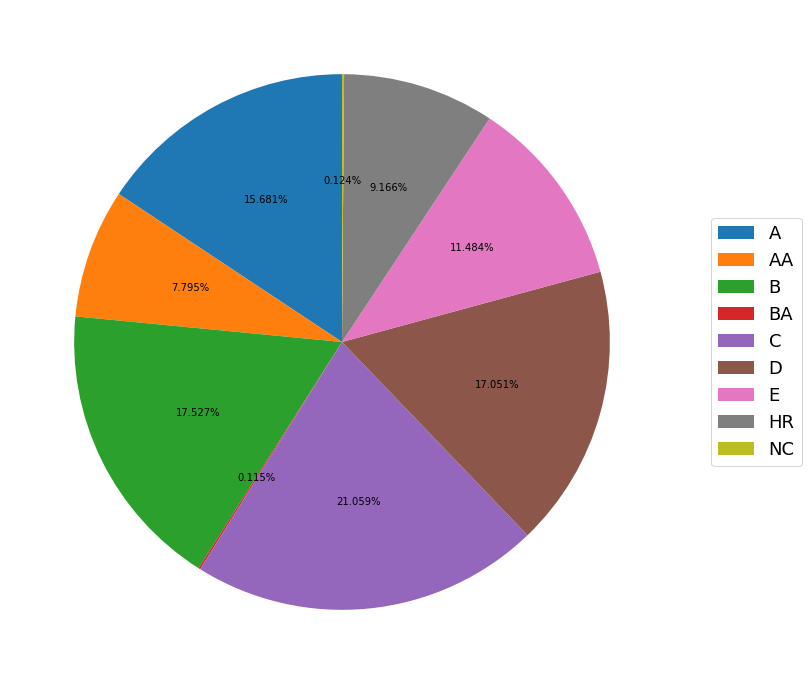

In [20]:
description = ["A", "AA", 'B', 'BA', "C", "D", 'E', 'HR', 'NC']
plt.figure(figsize = (12,15));
plt.pie(credit_rating_counts, startangle=90, autopct='%.3f%%');

plt.legend(labels=description, fontsize=18, loc='center right', 
           bbox_to_anchor=(1.2, 0.5));

### Observation

In [21]:
prosper['credit_rating'].isnull().sum()

0

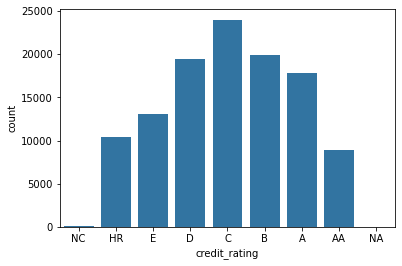

In [22]:
sb.countplot(data = prosper, x = 'credit_rating', color = dark_blue, 
             order = [ 'NC', 'HR', 'E', 'D', 'C', 'B',  'A', 'AA', 'NA'] );

In [23]:
prosper.head(5)

,listingkey,listingnumber,listingcreationdate,creditgrade,term,loanstatus,closeddate,borrowerapr,borrowerrate,lenderyield,estimatedeffectiveyield,estimatedloss,estimatedreturn,prosperrating (numeric),prosperrating (alpha),prosperscore,listingcategory (numeric),borrowerstate,occupation,employmentstatus,employmentstatusduration,isborrowerhomeowner,currentlyingroup,groupkey,datecreditpulled,creditscorerangelower,creditscorerangeupper,firstrecordedcreditline,currentcreditlines,opencreditlines,totalcreditlinespast7years,openrevolvingaccounts,openrevolvingmonthlypayment,inquirieslast6months,totalinquiries,currentdelinquencies,amountdelinquent,delinquencieslast7years,publicrecordslast10years,publicrecordslast12months,revolvingcreditbalance,bankcardutilization,availablebankcardcredit,totaltrades,tradesneverdelinquent (percentage),tradesopenedlast6months,debttoincomeratio,incomerange,incomeverifiable,statedmonthlyincome,loankey,totalprosperloans,totalprosperpaymentsbilled,ontimeprosperpayments,prosperpaymentslessthanonemonthlate,prosperpaymentsonemonthpluslate,prosperprincipalborrowed,prosperprincipaloutstanding,scorexchangeattimeoflisting,loancurrentdaysdelinquent,loanfirstdefaultedcyclenumber,loanmonthssinceorigination,loannumber,loanoriginalamount,loanoriginationdate,loanoriginationquarter,memberkey,monthlyloanpayment,lp_customerpayments,lp_customerprincipalpayments,lp_interestandfees,lp_servicefees,lp_collectionfees,lp_grossprincipalloss,lp_netprincipalloss,lp_nonprincipalrecoverypayments,percentfunded,recommendations,investmentfromfriendscount,investmentfromfriendsamount,investors,credit_rating
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,NaN,NaN,NaN,NaN,NaN,NaN,0,CO,Other,Self-employed,2.0,True,True,NaN,2007-08-26 18:41:46.780000000,640.0,659.0,2001-10-11 00:00:00,5.0,4.0,12.0,1,24.0,3.0,3.0,2.0,472.0,4.0,0.0,0.0,0.0,0.00,1500.0,11.0,0.81,0.0,0.17,"$25,000-49,999",True,3083.333333,E33A3400205839220442E84,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,78,19141,9425,2007-09-12 00:00:00,Q3 2007,1F3E3376408759268057EDA,330.43,11396.14,9425.00,1971.14,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258,C
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,0.07960,0.0249,0.05470,6.0,A,7.0,2,CO,Professional,Employed,44.0,False,False,NaN,2014-02-27 08:28:14,680.0,699.0,1996-03-18 00:00:00,14.0,14.0,29.0,13,389.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,3989.0,0.21,10266.0,29.0,1.00,2.0,0.18,"$50,000-74,999",True,6125.000000,9E3B37071505919926B1D82,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,134815,10000,2014-03-03 00:00:00,Q1 2014,1D13370546739025387B2F4,318.93,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1,A
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,NaN,NaN,NaN,NaN,NaN,NaN,0,GA,Other,Not available,NaN,False,True,783C3371218786870A73D20,2007-01-02 14:09:10.060000000,480.0,499.0,2002-07-27 00:00:00,NaN,NaN,3.0,0,0.0,0.0,1.0,1.0,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.06,Not displayed,True,2083.333333,6954337960046817851BCB2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,86,6466,3001,2007-01-17 00:00:00,Q1 2007,5F7033715035555618FA612,123.32,4186.63,3001.00,1185.63,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41,HR
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,0.08490,0.0249,0.06000,6.0,A,9.0,16,GA,Skilled Labor,Employed,113.0,True,False,NaN,2012-10-22 11:02:32,800.0,819.0,1983-02-28 00:00:00,5.0,5.0,29.0,7,115.0,0.0,1.0,4.0,10056.0,14.0,0.0,0.0,1444.0,0.04,30754.0,26.0,0.76,0.0,0.15,"$25,000-49,999",True,2875.000000,A0393664465886295619C51,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,16,77296,10000,2012-11-01 00:00:00,Q4 2012,9ADE356069835475068C6D2,321.45,5143.20,4091.09,1052.11,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158,A
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,0.18316,0.0925



>**Rubric Tip**: Visualizations should depict the data appropriately so that the plots are easily interpretable. You should choose an appropriate plot type, data encodings, and formatting as needed. The formatting may include setting/adding the title, labels, legend, and comments. Also, do not overplot or incorrectly plot ordinal data.

### Discuss the distribution(s) of your variable(s) of interest. Were there any unusual points? Did you need to perform any transformations?

> Your answer here!

### Of the features you investigated, were there any unusual distributions? Did you perform any operations on the data to tidy, adjust, or change the form of the data? If so, why did you do this?

> Your answer here!

## Bivariate Exploration

> In this section, investigate relationships between pairs of variables in your
data. Make sure the variables that you cover here have been introduced in some
fashion in the previous section (univariate exploration).

### Talk about some of the relationships you observed in this part of the investigation. How did the feature(s) of interest vary with other features in the dataset?

> Your answer here!

### Did you observe any interesting relationships between the other features (not the main feature(s) of interest)?

> Your answer here!

## Multivariate Exploration

> Create plots of three or more variables to investigate your data even
further. Make sure that your investigations are justified, and follow from
your work in the previous sections.

### Talk about some of the relationships you observed in this part of the investigation. Were there features that strengthened each other in terms of looking at your feature(s) of interest?

> Your answer here!

### Were there any interesting or surprising interactions between features?

> Your answer here!

## Conclusions
>You can write a summary of the main findings and reflect on the steps taken during the data exploration.



> Remove all Tips mentioned above, before you convert this notebook to PDF/HTML


> At the end of your report, make sure that you export the notebook as an
html file from the `File > Download as... > HTML or PDF` menu. Make sure you keep
track of where the exported file goes, so you can put it in the same folder
as this notebook for project submission. Also, make sure you remove all of
the quote-formatted guide notes like this one before you finish your report!

